# Pulling it all together
## 1. Cleaning, minor feature engineering, and filtering for NaNs post merge

In [104]:
import numpy as np
import pandas as pd
import csv
%pylab inline
import seaborn as sns
plt.rcParams['figure.dpi'] = 300
sns.set_style("darkgrid")


tracks=pd.read_csv('spotify5_10.csv',index_col=0)
tracks2=pd.read_csv('billboard_5_10.csv',index_col=0)

artists=pd.read_csv('artists_5_10.csv',index_col=0)
artists2=pd.read_csv('artist_info.csv',index_col=0)
artists3=pd.read_csv('artists_5_10_1.csv',index_col=0)



Populating the interactive namespace from numpy and matplotlib


/anaconda3/lib/python3.6/site-packages/IPython/core/magics/pylab.py:160: UserWarning: pylab import has clobbered these variables: ['grid', 'average']
`%matplotlib` prevents importing * from pylab and numpy
  "\n`%matplotlib` prevents importing * from pylab and numpy"


### Feature engineering genre from artist information
Spotify does not disclose the actual genre of a song, but a good proxy could be the genres that the artist is associated with (Song genre classification could be an interesting side project!). 

I used frequency of genres given for each artist to consolidate subgenres into overall genres. i.e., If an artist is tagged as "underground rap", he/she will get a 1 in the rap column.

In [106]:
artists2=artists2.append(artists)
artists2=artists2.append(artists3)
artists2['is_rap']=artists2.genres.str.contains('rap')
artists2['is_rap']=[1 if x==True else 0 for x in artists2['is_rap'] ]
artists2['is_edm']=artists2.genres.str.contains('edm')
artists2['is_edm']=[1 if x==True else 0 for x in artists2['is_edm'] ]
artists2['is_country']=artists2.genres.str.contains('country')
artists2['is_country']=[1 if x==True else 0 for x in artists2['is_country'] ]
artists2['is_rock']=artists2.genres.str.contains('rock')
artists2['is_rock']=[1 if x==True else 0 for x in artists2['is_rock'] ]
artists2['is_house']=artists2.genres.str.contains('house')
artists2['is_house']=[1 if x==True else 0 for x in artists2['is_house'] ]
artists2['is_hiphop']=artists2.genres.str.contains('hip hop')
artists2['is_hiphop']=[1 if x==True else 0 for x in artists2['is_hiphop'] ]
artists2['is_indie']=artists2.genres.str.contains('indie')
artists2['is_indie']=[1 if x==True else 0 for x in artists2['is_indie'] ]
artists2['is_jazz']=artists2.genres.str.contains('jazz')
artists2['is_jazz']=[1 if x==True else 0 for x in artists2['is_jazz'] ]
artists2.drop_duplicates(subset=['artist','uri'],inplace=True)
artists2.followers=artists2.followers+1
artists2.drop(columns='genres',inplace=True)
artists2.columns=['artist_name','followers','artist_uri','is_rap','is_edm','is_country','is_rock','is_house','is_hiphop','is_indie','is_jazz']



### Start to merge all DataFrames

In [107]:
tracks2['is_billboard']=1
tracks2=tracks2[tracks2.collabs<19]
tracks2.drop(columns=['duration_ms.1','popularity','album','artists','type','track_href','analysis_url','uri.1'],inplace=True)

In [108]:
#Removes skits and short, non musical clips
tracks=tracks[tracks.tempo!=0]
tracks.drop(columns=['duration_ms.1','popularity','album','artists','type','track_href','analysis_url','uri.1'],inplace=True)

In [112]:
track3=tracks.merge(tracks2,how='outer')

In [113]:
track3.is_billboard=track3.is_billboard.fillna(0)
track3=track3.merge(artists2,on='artist_uri',how='left')
track3.followers=track3.followers+1 # avoids a log 0 error
track3.is_billboard.value_counts()


0.0    17857
1.0     4339
Name: is_billboard, dtype: int64

In [114]:
track3[track3.isnull().any(axis=1)]['is_billboard'].value_counts()

In [115]:
track3.drop_duplicates(subset=['name','uri'],inplace=True)

In [116]:
track3.is_billboard=track3.is_billboard.astype(int)

In [117]:
track3=track3[~track3.isnull().any(axis=1)]


,duration_ms,explicit,id,name,uri,collabs,artist_name_x,artist_uri,release_date,acousticness,...,artist_name_y,followers,is_rap,is_edm,is_country,is_rock,is_house,is_hiphop,is_indie,is_jazz
0,232186,False,6SEDE7wvAnAtfdhu1zbUzi,Hands On You,spotify:track:6SEDE7wvAnAtfdhu1zbUzi,0,Ashley Monroe,spotify:artist:37BiX28I6pF104F92U1hDP,2018-04-20,0.031300,...,Ashley Monroe,10.934410,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0
1,222813,False,0efT4YKQLQx2YHbp6vgRX8,Someone New,spotify:track:0efT4YKQLQx2YHbp6vgRX8,0,Hozier,spotify:artist:2FXC3k01G6Gw61bmprjgqS,2014-10-07,0.429000,...,Hozier,14.608232,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,239733,False,2Bk0eoq8bN02TbqMlCLOHz,Everybody Lives,spotify:track:2Bk0eoq8bN02TbqMlCLOHz,0,Granger Smith,spotify:artist:4sTFGCigAQIUiEy8wSSQNF,2017-10-27,0.677000,...,Granger Smith,11.951406,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0
4,230200,False,38KkaiMlZHZ72cuoCgltVX,Sweet Summertime,spotify:track:38KkaiMlZHZ72cuoCgltVX,0,Candlebox,spotify:artist:3R6c2tWDBeYB1GncjLMn9n,2012-04-03,0.000125,...,Candlebox,12.419235,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
5,257186,False,02kGA6T5LwlhMm253ZlFMY,On My Heart,spotify:track:02kGA6T5LwlhMm253ZlFMY,0,School Of Seven Bells,spotify:artist:1mBdei7fcRpbUEYHgsQN9H,2016-02-12,0.000541,...,School Of Seven Bells,10.536380,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
6,188906,False,1kGMxiOni0S03K9hlFpdCe,Blonde,spotify:track:1kGMxiOni0S03K9hlFpdCe,0,Bridgit Mendler,spotify:artist:4VhL8KLjVso4vLfOLVViTb,2012-01-01,0.257000,...,Bridgit Mendler,13.567545,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7,241266,False,4KANJH1baadr3U7XsVbM17,Something I Need,spotify:track:4KANJH1baadr3U7XsVbM17,0,OneRepublic,spotify:artist:5Pwc4xIPtQLFEnJriah9YJ,2014-01-01,0.168000,...,OneRepublic,15.310790,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
8,334570,False,1BViPjTT585XAhkUUrkts0,Seigfried,spotify:track:1BViPjTT585XAhkUUrkts0,0,Frank Ocean,spotify:artist:2h93pZq0e7k5yf4dywlkpM,2016-08-20,0.975000,...,Frank Ocean,14.987266,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0
9,228093,True,05pdoheuKPSotkjMgIVX6I,Mirror,spotify:track:05pdoheuKPSotkjMgIVX6I,1,Lil Wayne,spotify:artist:55Aa2cqylxrFIXC767Z865,2011-01-01,0.859000,...,Lil Wayne,15.614122,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
11,222146,False,3UReTN3heQsznBG8edEcTU,Til I Get Found,spotify:track:3UReTN3heQsznBG8edEcTU,0,Marc E. Bassy,spotify:artist:3tQx1LPXbsYjE9VwN1Peaa,2017-10-13,0.072800,...,Marc E. Bassy,11.904407,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0


In [147]:
sns.pairplot(track3)

In [119]:
track3=track3.drop(columns=['followers','key','artist_name_y','id','name','uri','artist_name_x','artist_uri','release_date','id.1','time_signature','mode'])


In [121]:
track3.duration_ms=np.log(track3.duration_ms)
#Pairplotting idetnfies some outliers in collaborations and loudness. I add a filter to remove them
track3=track3[track3.collabs<10]
track3=track3[track3.loudness>-30]

## 2. Train-test-split and other Data Preprocessing

My target variable is whether or not the song will hit the billboard Hot-100.

In [125]:
#our Target varaiable is whether or not the 
y=track3.is_billboard
x=track3.drop(columns='is_billboard')


In [126]:
#changes explicit to a categorical type
for c in ['explicit']:
    x[c] = x[c].astype("category")
x = pd.get_dummies(x, dummy_na=False, drop_first=True)


,duration_ms,collabs,acousticness,danceability,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,is_rap,is_edm,is_country,is_rock,is_house,is_hiphop,is_indie,is_jazz,explicit_True
0,12.355294,0,0.031300,0.588,0.415,0.000014,0.1550,-8.912,0.0284,94.990,0.3070,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0
1,12.314088,0,0.429000,0.443,0.533,0.000004,0.3320,-5.956,0.0473,183.791,0.5960,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
2,12.387281,0,0.677000,0.625,0.538,0.000041,0.1090,-7.361,0.0330,80.057,0.2850,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0
4,12.346704,0,0.000125,0.472,0.911,0.000000,0.1400,-6.152,0.1470,144.121,0.3610,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0
5,12.457555,0,0.000541,0.531,0.568,0.002960,0.1830,-9.076,0.0235,92.997,0.1490,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0
6,12.149005,0,0.257000,0.709,0.675,0.000000,0.0842,-5.013,0.0700,180.001,0.7570,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
7,12.393655,0,0.168000,0.686,0.590,0.000000,0.1180,-6.923,0.0300,98.991,0.6290,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0
8,12.720601,0,0.975000,0.377,0.255,0.000208,0.1020,-11.165,0.0387,125.004,0.3700,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0
9,12.337509,1,0.859000,0.384,0.633,0.000000,0.1010,-7.144,0.1330,125.200,0.3600,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1
11,12.311090,0,0.072800,0.773,0.719,0.000000,0.2720,-6.471,0.0662,104.971,0.4100,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0


In [167]:
from sklearn.cross_validation import train_test_split
from imblearn.over_sampling import SMOTE
from sklearn import pipeline, preprocessing, neighbors, model_selection

xtrain, xtest, ytrain, ytest = train_test_split(x, y, test_size=0.25,stratify=y)




In [170]:
#creating a standard scaler on xtrain, and transforming it on xtest.
scaler=preprocessing.StandardScaler()
xtrain=scaler.fit_transform(xtrain)
xtest=scaler.transform(xtest)

In [175]:
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LogisticRegressionCV
logit= LogisticRegressionCV(cv=10)
logit.fit(xtrain,ytrain)
logit.score(xtest,ytest)

0.8075406604238541

## 3. Picking out an appropriate model

The below creates a confusion matrix which splits up results by TP,TN,FP, and FN.

In [176]:
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn import linear_model as lm
from sklearn import model_selection
from sklearn import metrics
from sklearn.metrics import confusion_matrix
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import LinearSVC

# Generate a confusion matrix plot: 
sns.set_style({'font.family':'serif', 'font.serif':'Verdana'})
def plot_confusion_matrix(cm,title='Confusion matrix', cmap=plt.cm.Reds):
    plt.imshow(cm, interpolation='nearest',cmap=cmap)
    plt.title(title)
    plt.colorbar()
    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')



def Accuracy_test(classifier,xtrain,ytrain,xtest,ytest):
    results=[]
    dict=({'Logistic Regression':LogisticRegressionCV(cv=10),
           'Linear SVC':LinearSVC(),
           'Decision Tree':DecisionTreeClassifier(),
           'Random Forest':RandomForestClassifier(),
           'Kernel SVM':SVC(),
           'SVC Poly':SVC(kernel='poly'),
           'KNN': KNeighborsClassifier(n_neighbors=5)
          }
            )
    for x in classifier:
        model=dict.get(x)
        fit=model.fit(xtrain,ytrain)
        train_acc=fit.score(xtrain,ytrain)
        test_acc=fit.score(xtest,ytest)
        y_true = ytest
        y_pred = fit.predict(xtest)
        conf = confusion_matrix(y_true, y_pred)
    
        results+=[[x,train_acc,test_acc,\
                   (conf[1, 1] / (conf[1, 1] + conf[0, 1])),\
                   (conf[1, 1] / (conf[1, 1] + conf[1, 0])),]]
                  
    
    return pd.DataFrame(results,columns=['Type','Train_acc','Test_acc','Precision','Recall'])

In [177]:
acc=Accuracy_test(['Logistic Regression','Decision Tree','SVC Poly','Random Forest','Kernel SVM','KNN'],xtrain,ytrain,xtest,ytest)

I want to compare how the ROC curve looks for various models.

In [228]:

from sklearn.metrics import roc_curve, auc,roc_auc_score
def ROC_plot(classifier,xtrain,ytrain,xtest,ytest):
    plt.figure(figsize=(8,8))
        # Plotting our Baseline..
    plt.plot([0,1],[0,1])
    plt.xlabel('FPR')
    plt.ylabel('TPR')
    plt.title('ROC Curve',size= 20)
    
    results=[]
    dict=({'Logistic Regression':LogisticRegressionCV(cv=10),
           'Linear SVC':LinearSVC(),
           'Decision Tree':DecisionTreeClassifier(),
           'Random Forest':RandomForestClassifier(),
           'Kernel SVM':SVC(probability=True),
           'SVC Poly':SVC(kernel='poly',probability=True),
           'KNN': KNeighborsClassifier(n_neighbors=10)
          }
            ) 
    for x in classifier:
        model = dict.get(x)
        model.fit(xtrain,np.ravel(ytrain))
        y_score=model.predict_proba(xtest)[:,1]
        fpr, tpr,_ = roc_curve(ytest, y_score)
        roc_auc = auc(fpr, tpr)
        results+=[[x,roc_auc_score(ytest, y_score)]]
        plt.plot(fpr,tpr,label=x)
    plt.legend()  
    
    return results

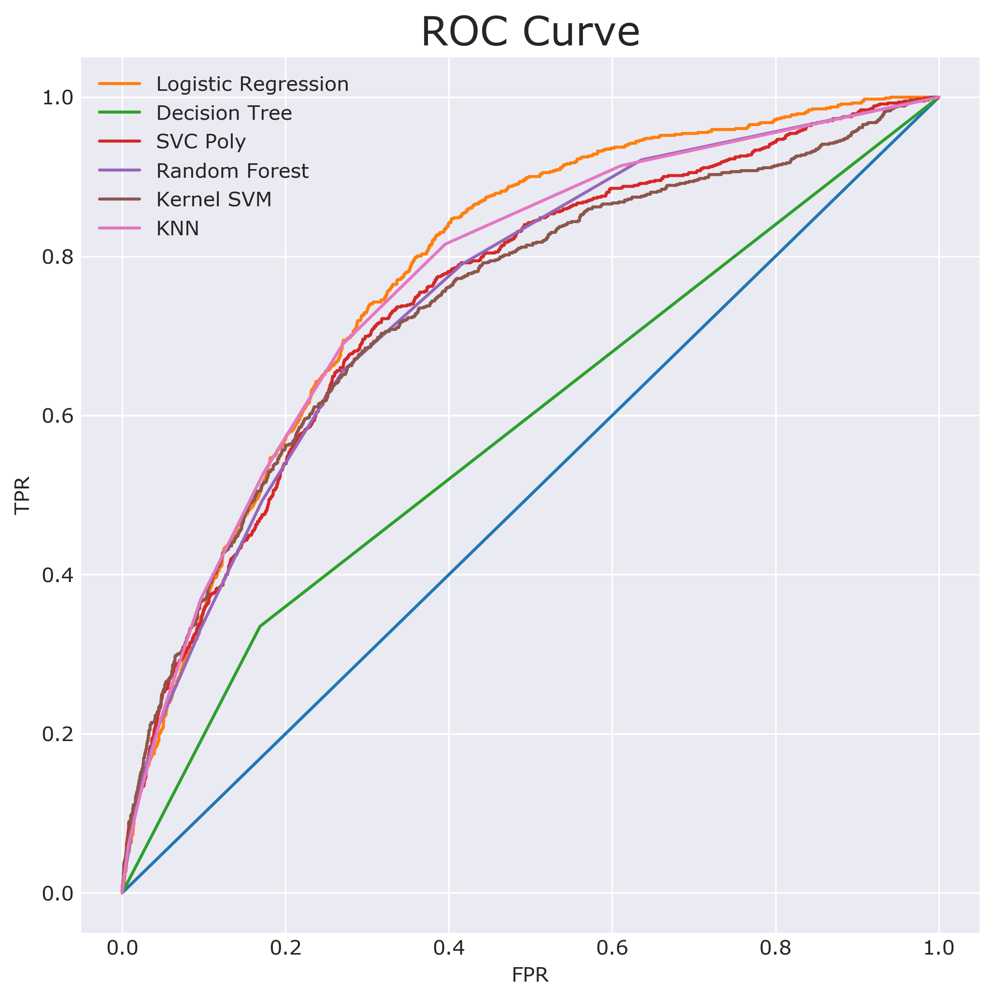

In [229]:
ROC=ROC_plot(['Logistic Regression','Decision Tree','SVC Poly','Random Forest','Kernel SVM','KNN'],xtrain,ytrain,xtest,ytest)

In [230]:
new_table=acc.join(pd.DataFrame(ROC))
new_table.drop(columns=0,inplace=True)
new_table.columns=['Model','Train Accuracy', 'Test Accuracy', 'Precision', 'Recall','AUC']


In [231]:
new_table

,Model,Train Accuracy,Test Accuracy,Precision,Recall,AUC
0,Logistic Regression,0.814851,0.807541,0.569507,0.156404,0.779656
1,Decision Tree,0.999918,0.730655,0.328029,0.330049,0.583076
2,SVC Poly,0.828733,0.808034,0.568465,0.168719,0.747332
3,Random Forest,0.984147,0.804091,0.527331,0.201970,0.750566
4,Kernel SVM,0.826680,0.812716,0.616071,0.169951,0.738656
5,KNN,0.856415,0.786348,0.449541,0.301724,0.766710


In [182]:
from  sklearn.metrics import precision_recall_curve

def PR_curve(classifier,xtrain,ytrain,xtest,ytest):

    
    results=[]
    dict=({'Logistic Regression':LogisticRegression(),
           'Linear SVC':LinearSVC(),
           'Decision Tree':DecisionTreeClassifier(),
           'Random Forest':RandomForestClassifier(),
           'Kernel SVM':SVC(probability=True),
           'SVC Poly':SVC(kernel='poly',probability=True),
           'KNN': KNeighborsClassifier(n_neighbors=5)
          }
            )
    
    plt.figure(figsize=(8,8))
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.title('Precision vs Recall', size=20)
    for x in classifier:
        model = dict.get(x)
        model.fit(xtrain,np.ravel(ytrain))
        y_score=model.predict_proba(xtest)[:,1]
        p,r,t=precision_recall_curve(ytest,y_score)
        t=np.vstack([t.reshape([-1,1]),1])
        plt.plot(r,p,label=x)
    
    
    plt.legend()  
    
    
    
    


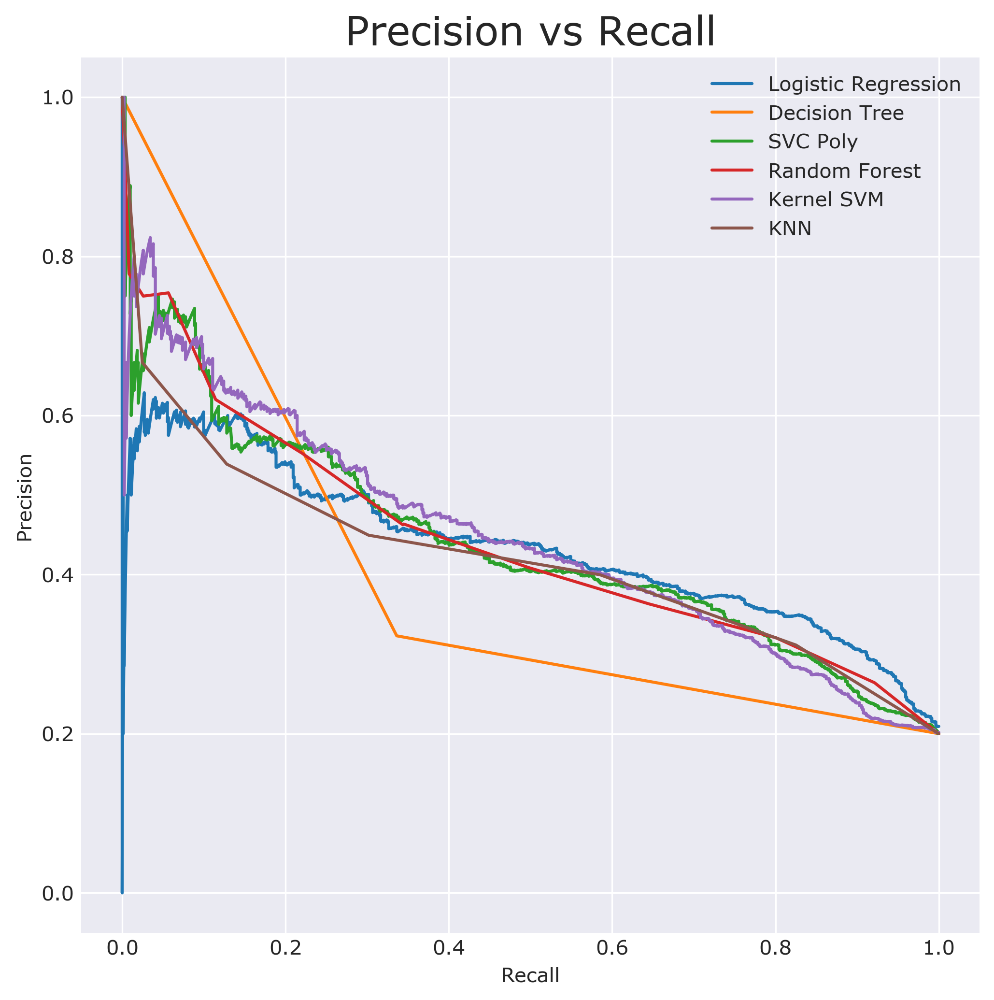

In [183]:
PR_curve(['Logistic Regression','Decision Tree','SVC Poly','Random Forest','Kernel SVM','KNN'],xtrain,ytrain,xtest,ytest)

# HyperParameter Tuning Logistic Regression

In [184]:
from sklearn.model_selection import GridSearchCV

In [185]:
model1=LogisticRegression()
param_grid = {'C': [.00001 ,0.001, 0.005, 0.01,1],\
             'class_weight': [None,'balanced'],\
              'penalty':['l2']
             }
grid = GridSearchCV(LogisticRegression(), param_grid,cv=10,scoring='recall')
grid.fit(xtrain,ytrain)
print(grid.best_score_)
model1.set_params(**grid.best_params_)

0.7893239702782301


LogisticRegression(C=0.001, class_weight='balanced', dual=False,
          fit_intercept=True, intercept_scaling=1, max_iter=100,
          multi_class='ovr', n_jobs=1, penalty='l2', random_state=None,
          solver='liblinear', tol=0.0001, verbose=0, warm_start=False)

In [187]:
fit=model1.fit(xtrain,ytrain)
train_acc=fit.score(xtrain,ytrain)
test_acc=fit.score(xtest,ytest)
print("Training Data Accuracy: %0.2f" %(train_acc))
print("Test Data Accuracy:     %0.2f" %(test_acc))
y_true = ytest
y_pred = fit.predict(xtest)
conf = confusion_matrix(y_true, y_pred)
print(conf)
print ('\n')
print ("Precision:              %0.2f" %(conf[1, 1] / (conf[1, 1] + conf[0, 1])))
print ("Recall:                 %0.2f"% (conf[1, 1] / (conf[1, 1] +conf[1,0])))
print ('F1-Score:               %0.2f'% (2.0*((conf[1, 1] / (conf[1, 1] + conf[0, 1]))*(conf[1, 1] / (conf[1, 1] + conf[1, 0])))/((conf[1, 1] / (conf[1, 1] + conf[0, 1]))+(conf[1, 1] / (conf[1, 1] + conf[1, 0])))))

Training Data Accuracy: 0.68
Test Data Accuracy:     0.68
[[2121 1125]
 [ 178  634]]


Precision:              0.36
Recall:                 0.78
F1-Score:               0.49


Text(0.5,1,'Confusion matrix @ .50 Threshold')

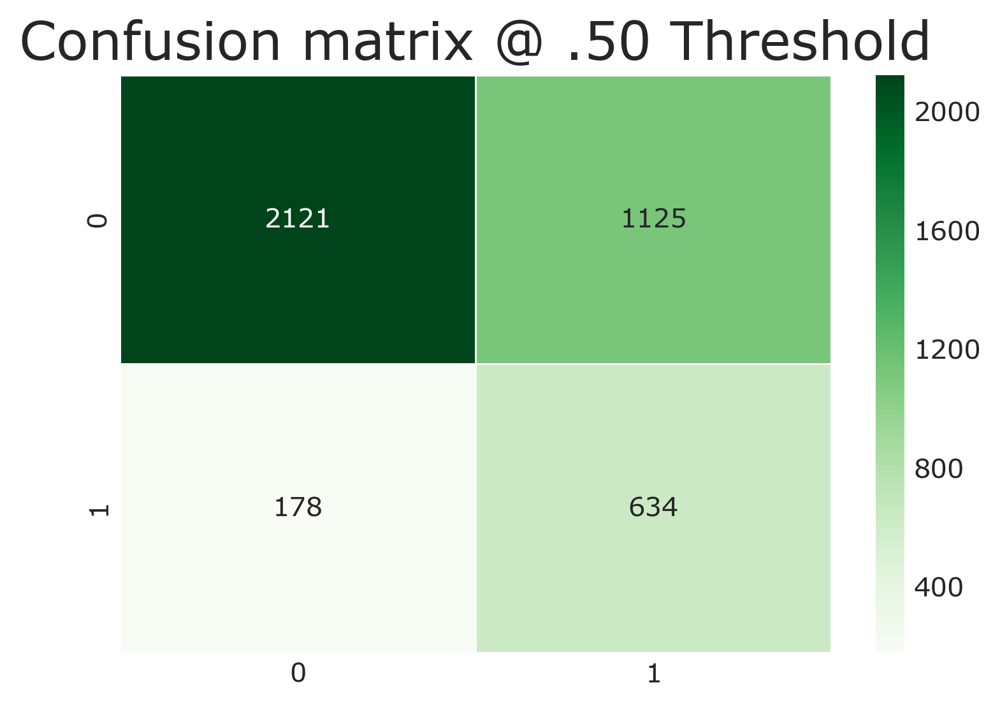

In [188]:
sns.heatmap(conf, annot=True,fmt='g',linewidths=.5,cmap="Greens")
title('Confusion matrix @ .50 Threshold',size=20)

In [189]:
coef=list(zip(x.columns,fit.coef_[0]))
coef

[('duration_ms', -0.07483300906916986),
 ('collabs', 0.07568246430238133),
 ('acousticness', -0.05926223372350847),
 ('danceability', 0.26555271428206184),
 ('energy', -0.17765404055460648),
 ('instrumentalness', -0.18799555264136447),
 ('liveness', -0.03820638579645234),
 ('loudness', 0.20610108015399498),
 ('speechiness', -9.97898359245189e-05),
 ('tempo', 0.032181764614346575),
 ('valence', 0.06148569165758593),
 ('is_rap', 0.1385475560842436),
 ('is_edm', 0.08641235802922215),
 ('is_country', 0.2169675321160387),
 ('is_rock', -0.35594186177628506),
 ('is_house', -0.10496114431512579),
 ('is_hiphop', 0.08815153315271226),
 ('is_indie', -0.28247595648820123),
 ('is_jazz', -0.06826077922183596),
 ('explicit_True', 0.11835971270585033)]

Text(0.5,1,'Coefficient Plot')

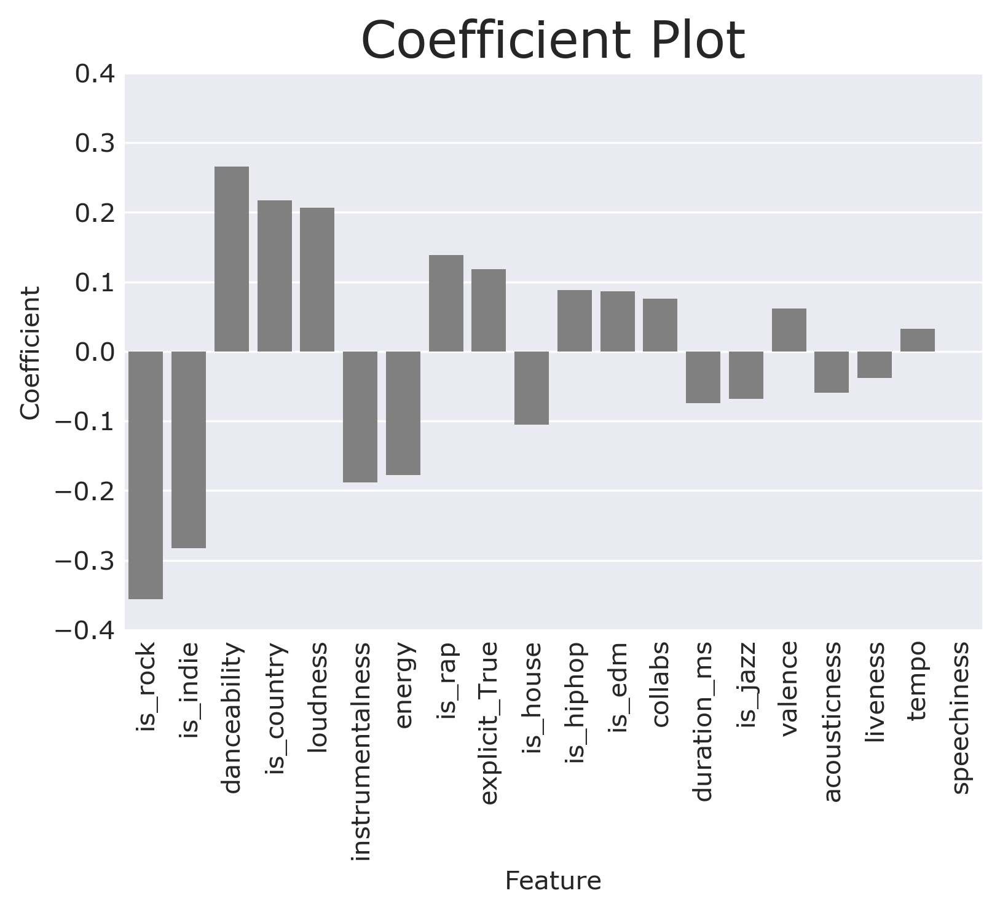

In [192]:
sns.barplot(coefmap[0],coefmap[1],color='grey')
ax = plt.gca();
plt.setp(ax.get_xticklabels(), rotation=90);
ylabel('Coefficient');
ylim(-.4,.4)
xlabel('Feature');
title('Coefficient Plot',size=20)

array([[0.63906366],
       [0.63912805]])

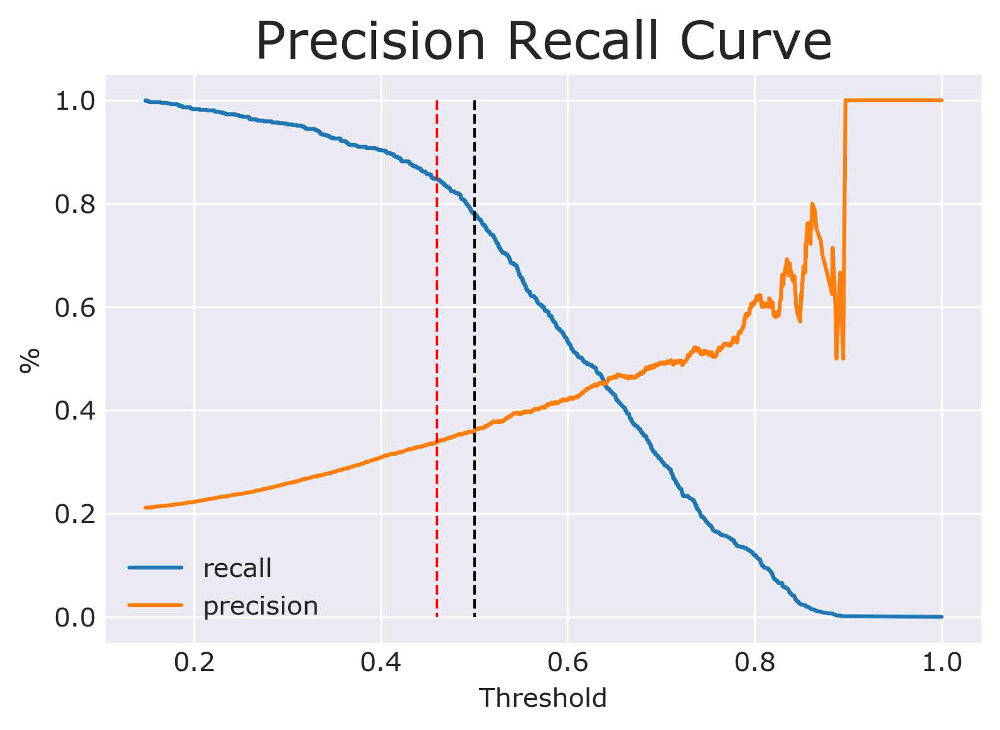

In [212]:
y_score=fit.predict_proba(xtest)[:,1]
p,r,t=precision_recall_curve(ytest,y_score)
t=np.vstack([t.reshape([-1,1]),1])
idx=np.argwhere(np.diff(np.sign(p - r )) != 0).reshape(-1) + 0

plt.plot(t,r,label='recall',)
plt.plot(t,p,label='precision')

plt.legend()
plt.plot([.5,.5],[1,0],'--',color='black',linewidth=1,label='.5 threshold')
plt.plot([.46,.46],[1,0],'--',color='red',linewidth=1,label='.46 threshold')

plt.title('Precision Recall Curve',size=20)
plt.xlabel('Threshold')
plt.ylabel('%')
t[idx]

In [218]:
rshape=r.reshape([-1,1])
pshape=p.reshape([-1,1])
t,rshape,pshape
threshold=pd.DataFrame(list((zip(np.concatenate(t),r,p))))
threshold.columns=['Threshold','Recall','Precision']
threshold=threshold.sort_values(by='Threshold',ascending=False)
threshold

,Threshold,Recall,Precision
3843,1.000000,0.000000,1.000000
3842,0.897176,0.001232,1.000000
3841,0.894661,0.001232,0.500000
3840,0.891450,0.002463,0.666667
3839,0.887449,0.002463,0.500000
3838,0.886416,0.003695,0.600000
3837,0.884647,0.004926,0.666667
3836,0.883377,0.006158,0.714286
3835,0.882888,0.006158,0.625000
3834,0.877310,0.007389,0.666667


In [219]:
threshold['recall_diff']=threshold.Recall.diff()
threshold['Precision_diff']=threshold.Precision.diff()
threshold

,Threshold,Recall,Precision,recall_diff,Precision_diff
3843,1.000000,0.000000,1.000000,NaN,NaN
3842,0.897176,0.001232,1.000000,0.001232,0.000000
3841,0.894661,0.001232,0.500000,0.000000,-0.500000
3840,0.891450,0.002463,0.666667,0.001232,0.166667
3839,0.887449,0.002463,0.500000,0.000000,-0.166667
3838,0.886416,0.003695,0.600000,0.001232,0.100000
3837,0.884647,0.004926,0.666667,0.001232,0.066667
3836,0.883377,0.006158,0.714286,0.001232,0.047619
3835,0.882888,0.006158,0.625000,0.000000,-0.089286
3834,0.877310,0.007389,0.666667,0.001232,0.041667


In [220]:
freq_bins = np.linspace(0, 1, 21)
freq_bins=['%g'%(x)for x in freq_bins]

def map_bin(x, bins):
    kwargs = {}
    if x == max(bins):
        kwargs['right'] = True
    bin = bins[np.digitize([x], bins, **kwargs)[0]]
    bin_lower = bins[np.digitize([x], bins, **kwargs)[0]-1]
    return '[{0}-{1}]'.format(bin_lower, bin)
print(freq_bins)

['0', '0.05', '0.1', '0.15', '0.2', '0.25', '0.3', '0.35', '0.4', '0.45', '0.5', '0.55', '0.6', '0.65', '0.7', '0.75', '0.8', '0.85', '0.9', '0.95', '1']


In [221]:

threshold=threshold.dropna()
threshold
threshold['Binned'] = threshold['Threshold'].apply(map_bin, bins=freq_bins)
threshold



/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  after removing the cwd from sys.path.


,Threshold,Recall,Precision,recall_diff,Precision_diff,Binned
3842,0.897176,0.001232,1.000000,0.001232,0.000000,[0.85-0.9]
3841,0.894661,0.001232,0.500000,0.000000,-0.500000,[0.85-0.9]
3840,0.891450,0.002463,0.666667,0.001232,0.166667,[0.85-0.9]
3839,0.887449,0.002463,0.500000,0.000000,-0.166667,[0.85-0.9]
3838,0.886416,0.003695,0.600000,0.001232,0.100000,[0.85-0.9]
3837,0.884647,0.004926,0.666667,0.001232,0.066667,[0.85-0.9]
3836,0.883377,0.006158,0.714286,0.001232,0.047619,[0.85-0.9]
3835,0.882888,0.006158,0.625000,0.000000,-0.089286,[0.85-0.9]
3834,0.877310,0.007389,0.666667,0.001232,0.041667,[0.85-0.9]
3833,0.872542,0.008621,0.700000,0.001232,0.033333,[0.85-0.9]


In [227]:
thresh=pd.DataFrame(fit.predict_proba(xtest))
thresh['y_t']=[1 if x>.46 else 0 for x in thresh[1]]
y_t=thresh['y_t']
fit=model1.fit(xtrain,ytrain)
train_acc=fit.score(xtrain,ytrain)
test_acc=fit.score(xtest,ytest)
print("Training Data Accuracy: %0.2f" %(train_acc))
print("Test Data Accuracy:     %0.2f" %(test_acc))
y_true = ytest
y_pred = y_t
conf = confusion_matrix(y_true, y_t)
print(conf)
print ('\n')
print ("Precision:              %0.2f" %(conf[1, 1] / (conf[1, 1] + conf[0, 1])))
print ("Recall:                 %0.2f"% (conf[1, 1] / (conf[1, 1] +conf[1,0])))
print ('F1-Score:               %0.2f'% (2.0*((conf[1, 1] / (conf[1, 1] + conf[0, 1]))*(conf[1, 1] / (conf[1, 1] + conf[1, 0])))/((conf[1, 1] / (conf[1, 1] + conf[0, 1]))+(conf[1, 1] / (conf[1, 1] + conf[1, 0])))))

Training Data Accuracy: 0.68
Test Data Accuracy:     0.68
[[1899 1347]
 [ 124  688]]


Precision:              0.34
Recall:                 0.85
F1-Score:               0.48


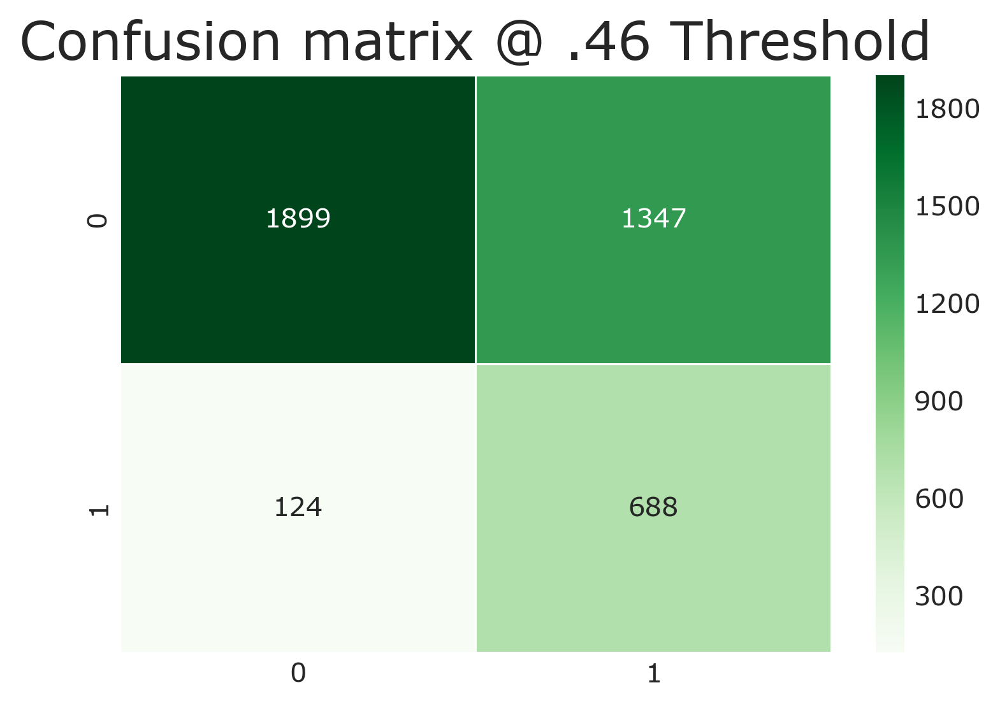

In [200]:
sns.heatmap(conf, annot=True,fmt='g',linewidths=.5,cmap="Greens")
title('Confusion matrix @ .46 Threshold',size=20);

# HyperParameter Tuning Random Forest

I also tried to tune Random Forests for Recall. I was pretty unsuccessful with this.

In [127]:
from sklearn.model_selection import RandomizedSearchCV
# Number of trees in random forest
n_estimators = [int(x) for x in np.linspace(start = 50, stop = 1000, num = 20)]
# Number of features to consider at every split
max_features = ['auto',None]
# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(10, 50, num = 11)]
max_depth.append(None)
# Minimum number of samples required to split a node
min_samples_split = [10,15,30]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4]
# Method of selecting samples for training each tree
bootstrap = [True, False]
# Create the random grid
random_grid = {'n_estimators': n_estimators,
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
               'bootstrap': bootstrap}
# Use the random grid to search for best hyperparameters
# First create the base model to tune
rf = RandomForestClassifier()
# Random search of parameters, using 3 fold cross validation, 
# search across 100 different combinations, and use all available cores
rf_random = RandomizedSearchCV(estimator = rf, param_distributions = random_grid, n_iter = 40, cv = 3, verbose=2, random_state=42, n_jobs = -1,scoring='recall')
# Fit the random search model
rf_random.fit(xtrain, ytrain)

Fitting 3 folds for each of 40 candidates, totalling 120 fits
[CV] n_estimators=550, min_samples_split=10, min_samples_leaf=2, max_features=auto, max_depth=42, bootstrap=False 
[CV] n_estimators=550, min_samples_split=10, min_samples_leaf=2, max_features=auto, max_depth=42, bootstrap=False 
[CV] n_estimators=550, min_samples_split=10, min_samples_leaf=2, max_features=auto, max_depth=42, bootstrap=False 
[CV] n_estimators=50, min_samples_split=15, min_samples_leaf=4, max_features=auto, max_depth=18, bootstrap=True 
[CV]  n_estimators=50, min_samples_split=15, min_samples_leaf=4, max_features=auto, max_depth=18, bootstrap=True, total=   1.1s
[CV] n_estimators=50, min_samples_split=15, min_samples_leaf=4, max_features=auto, max_depth=18, bootstrap=True 
[CV]  n_estimators=50, min_samples_split=15, min_samples_leaf=4, max_features=auto, max_depth=18, bootstrap=True, total=   1.1s
[CV] n_estimators=50, min_samples_split=15, min_samples_leaf=4, max_features=auto, max_depth=18, bootstrap=True

[CV] n_estimators=500, min_samples_split=30, min_samples_leaf=1, max_features=auto, max_depth=18, bootstrap=True 
[CV]  n_estimators=300, min_samples_split=10, min_samples_leaf=2, max_features=None, max_depth=26, bootstrap=True, total=  35.2s
[CV] n_estimators=500, min_samples_split=30, min_samples_leaf=2, max_features=auto, max_depth=38, bootstrap=False 


[Parallel(n_jobs=-1)]: Done  33 tasks      | elapsed:  4.3min


[CV]  n_estimators=300, min_samples_split=10, min_samples_leaf=2, max_features=None, max_depth=26, bootstrap=True, total=  35.1s
[CV] n_estimators=500, min_samples_split=30, min_samples_leaf=2, max_features=auto, max_depth=38, bootstrap=False 
[CV]  n_estimators=300, min_samples_split=10, min_samples_leaf=2, max_features=None, max_depth=26, bootstrap=True, total=  34.7s
[CV] n_estimators=500, min_samples_split=30, min_samples_leaf=2, max_features=auto, max_depth=38, bootstrap=False 
[CV]  n_estimators=500, min_samples_split=30, min_samples_leaf=1, max_features=auto, max_depth=18, bootstrap=True, total=  11.3s
[CV] n_estimators=700, min_samples_split=15, min_samples_leaf=2, max_features=None, max_depth=34, bootstrap=True 
[CV]  n_estimators=500, min_samples_split=30, min_samples_leaf=2, max_features=auto, max_depth=38, bootstrap=False, total=  16.7s
[CV] n_estimators=700, min_samples_split=15, min_samples_leaf=2, max_features=None, max_depth=34, bootstrap=True 
[CV]  n_estimators=500, m

[CV]  n_estimators=500, min_samples_split=30, min_samples_leaf=2, max_features=None, max_depth=46, bootstrap=False, total= 1.3min
[CV] n_estimators=400, min_samples_split=10, min_samples_leaf=2, max_features=None, max_depth=30, bootstrap=True 
[CV]  n_estimators=400, min_samples_split=10, min_samples_leaf=2, max_features=None, max_depth=30, bootstrap=True, total=  42.4s
[CV] n_estimators=400, min_samples_split=30, min_samples_leaf=1, max_features=None, max_depth=38, bootstrap=True 
[CV]  n_estimators=400, min_samples_split=10, min_samples_leaf=2, max_features=None, max_depth=30, bootstrap=True, total=  41.3s
[CV] n_estimators=400, min_samples_split=30, min_samples_leaf=1, max_features=None, max_depth=38, bootstrap=True 
[CV]  n_estimators=400, min_samples_split=10, min_samples_leaf=2, max_features=None, max_depth=30, bootstrap=True, total=  41.3s
[CV] n_estimators=400, min_samples_split=30, min_samples_leaf=1, max_features=None, max_depth=38, bootstrap=True 
[CV]  n_estimators=500, min

[CV]  n_estimators=850, min_samples_split=10, min_samples_leaf=4, max_features=None, max_depth=46, bootstrap=True, total= 1.3min
[CV] n_estimators=700, min_samples_split=30, min_samples_leaf=4, max_features=None, max_depth=18, bootstrap=False 
[CV]  n_estimators=850, min_samples_split=10, min_samples_leaf=4, max_features=None, max_depth=46, bootstrap=True, total= 1.2min
[CV] n_estimators=700, min_samples_split=30, min_samples_leaf=4, max_features=None, max_depth=18, bootstrap=False 
[CV]  n_estimators=550, min_samples_split=30, min_samples_leaf=2, max_features=None, max_depth=50, bootstrap=True, total=  50.1s
[CV] n_estimators=700, min_samples_split=30, min_samples_leaf=4, max_features=None, max_depth=18, bootstrap=False 
[CV]  n_estimators=550, min_samples_split=30, min_samples_leaf=2, max_features=None, max_depth=50, bootstrap=True, total=  48.2s
[CV] n_estimators=700, min_samples_split=15, min_samples_leaf=4, max_features=auto, max_depth=None, bootstrap=False 
[CV]  n_estimators=700

[Parallel(n_jobs=-1)]: Done 120 out of 120 | elapsed: 22.6min finished


RandomizedSearchCV(cv=3, error_score='raise',
          estimator=RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=10, n_jobs=1,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False),
          fit_params=None, iid=True, n_iter=40, n_jobs=-1,
          param_distributions={'n_estimators': [50, 100, 150, 200, 250, 300, 350, 400, 450, 500, 550, 600, 650, 700, 750, 800, 850, 900, 950, 1000], 'max_features': ['auto', None], 'max_depth': [10, 14, 18, 22, 26, 30, 34, 38, 42, 46, 50, None], 'min_samples_split': [10, 15, 30], 'min_samples_leaf': [1, 2, 4], 'bootstrap': [True, False]},
          pre_dispatch='2*n_jobs', random_state=42, refit=True,
          return_train_score='warn', scoring='re

In [128]:
rf=rf_random.best_params_

In [129]:
rf

{'bootstrap': False,
 'max_depth': 38,
 'max_features': None,
 'min_samples_leaf': 1,
 'min_samples_split': 15,
 'n_estimators': 100}

In [130]:
RandomForestClassifier().set_params(**rf_random.best_params_)

rf2=RandomForestClassifier().fit(xtrain,ytrain)
train_acc=rf2.score(xtrain,ytrain)
test_acc=rf2.score(xtest,ytest)
print("Training Data Accuracy: %0.2f" %(train_acc))
print("Test Data Accuracy:     %0.2f" %(test_acc))
y_true = ytest
y_pred = rf2.predict(xtest)
conf = confusion_matrix(y_true, y_pred)
print(conf)
print ('\n')
print ("Precision:              %0.2f" %(conf[1, 1] / (conf[1, 1] + conf[0, 1])))
print ("Recall:                 %0.2f"% (conf[1, 1] / (conf[1, 1] +conf[1,0])))
print ('F1-Score:               %0.2f'% (2.0*((conf[1, 1] / (conf[1, 1] + conf[0, 1]))*(conf[1, 1] / (conf[1, 1] + conf[1, 0])))/((conf[1, 1] / (conf[1, 1] + conf[0, 1]))+(conf[1, 1] / (conf[1, 1] + conf[1, 0])))))

Training Data Accuracy: 0.99
Test Data Accuracy:     0.82
[[3069  177]
 [ 543  269]]


Precision:              0.60
Recall:                 0.33
F1-Score:               0.43
